<a href="https://colab.research.google.com/github/Uhbifg/universiry-5/blob/master/temp1.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **Домашнее задание #5. Раскраски для взрослых**

Сегодня наконец-то займемся настоящими делами. Будем повторять подвиг создателей [pix2pix](https://github.com/junyanz/pytorch-CycleGAN-and-pix2pix), только на своем датасете. Данные бери [тут](https://drive.google.com/file/d/1Uh7eFfQy3iJU8voK2CmJ-jqQEN4TtSS8/view?usp=sharing). 

За основу работы будем брать оригинальный репозиторий (там надо будет покопаться и взять нужные части, но **не копировать всё тупо, умоляю**), а ещё нужно хорошо разобраться в [статье](https://arxiv.org/pdf/1611.07004.pdf). 

## **Часть 1**. Смотрим на данные (2 балла)

**Стандартный алгоритм**:

1. Закинь архив с данными на `gdrive`, примонтируй диск,  
2. Используй `ImageFolder` для подгрузки данных (посмотри доки насчет организации папки) в `Dataset`, `transform` пока используй аналогично тому, что был в семинаре (1 балл)
3. Отрисуй несколько семплов из трейна и теста (тут надо не забыть разнормализацию, а то атата) (1 балл). 

In [1]:
import os
import random
import argparse
import functools
import torch
import torch.nn as nn
from torch.nn import init
import torch.nn.parallel
import torch.backends.cudnn as cudnn
import torch.optim as optim
import torch.utils.data
import torchvision.datasets as datasets
import torchvision.transforms as transforms
import torchvision.utils as vutils
from torch.optim.lr_scheduler import LambdaLR

import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation

from IPython.display import HTML

import glob
from torch.utils.data import Dataset
from PIL import Image


manualSeed = 24
random.seed(manualSeed)
torch.manual_seed(manualSeed)
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
%matplotlib inline

In [2]:
#маунтим
from google.colab import drive
drive.mount("/content/drive")

!mkdir train_data
!mkdir train_data/data

!mkdir test_data
!mkdir test_data/data


!unzip -q "/content/drive/MyDrive/pokemon.zip" -d "data"
!cp -a /content/data/pokemon/test/. /content/test_data/data
!cp -a /content/data/pokemon/train/. /content/train_data/data

Mounted at /content/drive


In [3]:
image_size = 256
transform=transforms.Compose([ transforms.Resize(image_size),
                               transforms.CenterCrop(image_size),
                               transforms.ToTensor(),
                               transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))])

dataset_train = datasets.ImageFolder(root='/content/train_data',  transform=transform)
dataset_test = datasets.ImageFolder(root='/content/test_data',  transform=transform)

In [4]:
def unnormalize_img(img):
    return transforms.Normalize((-1, -1, -1), (1/0.5, 1/0.5, 1/0.5))(img).permute(1, 2, 0)

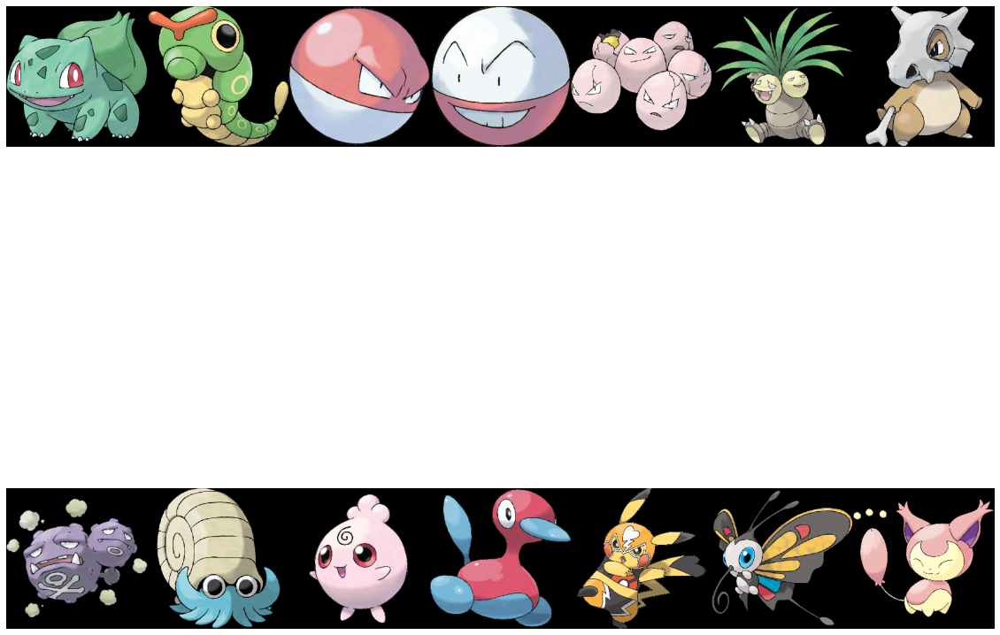

In [5]:
size = 7
fig, ax = plt.subplots(2, size, figsize=(20, 20))
fig.subplots_adjust(hspace = .005, wspace=.001)
for i, img in enumerate(dataset_train):
    img = img[0]
    ax.flatten()[i].imshow(unnormalize_img(img))
    ax.flatten()[i].axis('off')

    if i == size - 1:
        break
size = 7
for i, img in enumerate(dataset_test):
    img = img[0]
    ax.flatten()[i + size].imshow(unnormalize_img(img))
    ax.flatten()[i + size].axis('off')

    if i == size - 1:
        break


Итак, что же мы хотим? Мы хотим научить GAN раскрашивать покемона по его границам, а значит принцип такой:

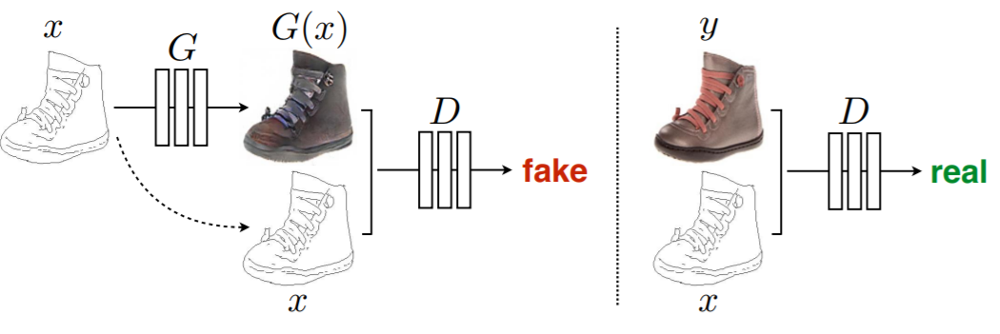

Для обучения GANа для такой задачи нам понадобится парный датасет - для каждой оригинальной картинки нужна карта границ. 



**1.** Напиши функцию ```get_boarders(img) ```, которая будет для изображения получать границы (3 балла). Сделай визуализацию великолепной работы твоей функции на 3-4 примерах. 

**NB**. Какие тут варианты сразу приходят на ум: отделить черные пиксели просто по порогу на цвет, остальные перевести в белые. Если тебя смущают терные элементы на покемонах - можно использовать фильтры для выделения границ, например [Canny](https://scikit-image.org/docs/dev/api/skimage.feature.html#canny). Если границы получаются слишком тонкими и рвутся - можно по бинарной картинке пройтись морфологией - использовать [дилатацию](https://scikit-image.org/docs/dev/api/skimage.morphology.html#binary-dilation), например. 

**2.** Заводим `class PairedDataset`, который будет выдавать парочки - $A$ (границы) и $B$ (покемона), смотрим что с ним всё окей (3 балла).

**NB**. Какие тут очевидные стратегии:
- либо с помощью ```get_boarders(img) ``` предобработать каждую картинку и положить рядом с оригинальными (например с теми же именами но в соседнюю папку, а в Датасете хранить разные пути к границам и оригиналу (мы там делали в задании с дететкором фактически)
- либо для читаемой картинки в своем `PairedDataset` классе получать карту границ и на выход из датасета подавать картинку и её только что посчитанные границы.   

In [6]:
from skimage.feature import canny
from skimage.morphology import binary_dilation
from skimage.color import rgb2gray

In [7]:
!pip install colorthief

In [8]:
from colorthief import ColorThief

In [9]:
def get_borders(img):
    gray = rgb2gray(img.permute(1, 2, 0))
    can = canny(gray, 2.5)
    can = binary_dilation(can)
    result = torch.from_numpy(can).float()
    return result.unsqueeze(0)

def get_colored_borders(img, path):
    color_thief = ColorThief(path)
    dominant_color = color_thief.get_color(quality=1)
    gray = rgb2gray(img.permute(1, 2, 0))
    can = canny(gray, 2.5)
    can = binary_dilation(can)
    result = torch.from_numpy(can).float()
    result.unsqueeze_(0)
    result = result.repeat(3, 1, 1)
    for i in range(3):
        result[i, :, :] *= dominant_color[i]
    result /= 255.0
    return result


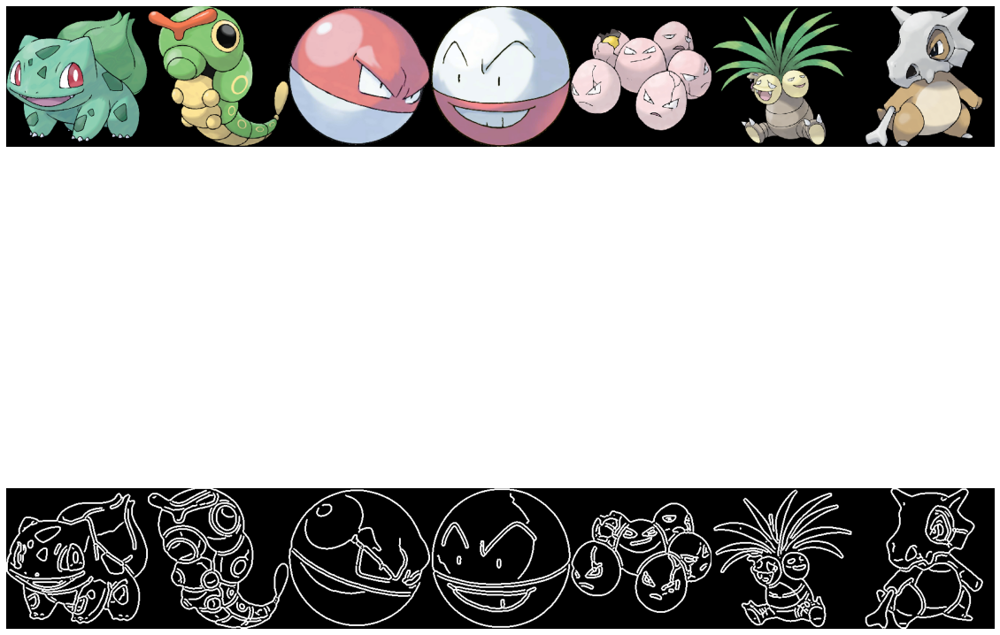

In [10]:
size = 7
fig, ax = plt.subplots(2, size, figsize=(20, 20))
fig.subplots_adjust(hspace = .005, wspace=.001)
for i, img in enumerate(dataset_train):
    img = img[0]
    ax.flatten()[i].imshow(unnormalize_img(img))
    ax.flatten()[i].axis('off')

    if i == size - 1:
        break


for i, img in enumerate(dataset_train):
    img = img[0]
    ax.flatten()[i + size].imshow(get_borders(img).squeeze(0), cmap=plt.cm.gray)
    ax.flatten()[i + size].axis('off')

    if i == size - 1:
        break


In [11]:

class PairedDataset(Dataset):
    def __init__(self, path, transform=None, cache=True, colored=False):
        self.names = glob.glob(path + "/*.png")
        self.images = list()
        for name in self.names:
            image = Image.open(name).convert('RGB')
            if transform:
                image = transform(image)
            self.images.append(image)
        
        self.length = len(self.images)
        self.path = path
        self.cached = cache
        self.colored = colored

        if cache:
            self.cached_borders = list()
            for i, img in enumerate(self.images):
                if colored:
                    self.cached_borders.append(get_colored_borders(img, self.names[i]))
                else:
                    self.cached_borders.append(get_borders(img))
                    
    def __len__(self):
        return self.length

    def __getitem__(self, idx): 
        if self.cached:
            return (self.images[idx], self.cached_borders[idx])
        else:
            if self.colored:
                return (self.images[idx], get_colored_borders(self.images[idx], self.names[idx]))
            else:
                return (self.images[idx], get_borders(self.images[idx]))

In [12]:
dataset_test = PairedDataset("/content/test_data/data", transform=transform)
dataset_train = PairedDataset("/content/train_data/data", transform=transform)

Проверим, что все работает:

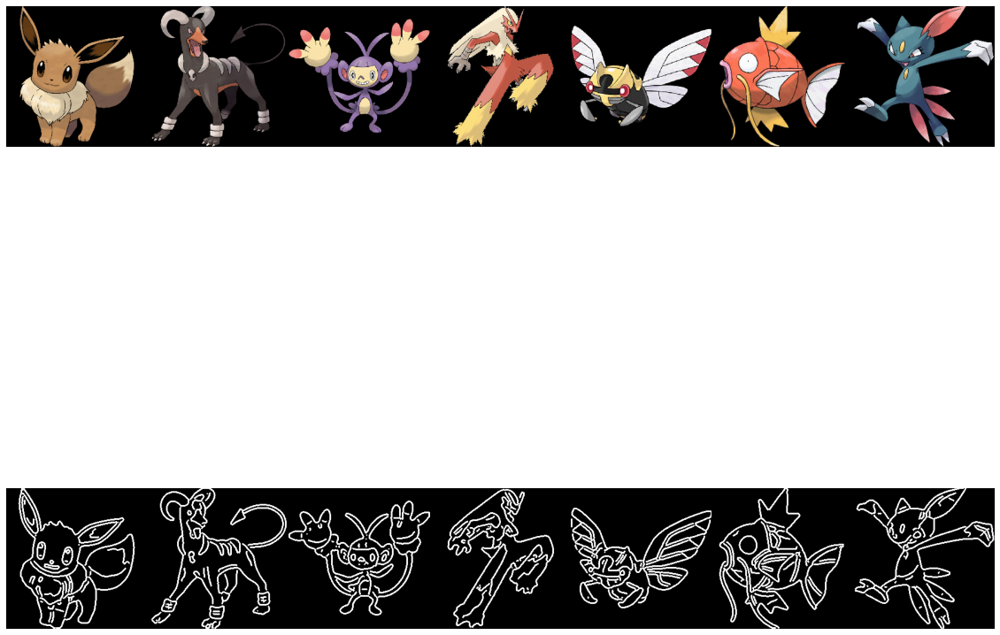

In [13]:
size = 7
fig, ax = plt.subplots(2, size, figsize=(20, 20))
fig.subplots_adjust(hspace = .005, wspace=.001)
for i, img in enumerate(dataset_train):
    img = img[0]
    ax.flatten()[i].imshow(unnormalize_img(img))
    ax.flatten()[i].axis('off')

    if i == size - 1:
        break


for i, img in enumerate(dataset_train):
    img = img[1]
    ax.flatten()[i + size].imshow(img.squeeze(0), cmap=plt.cm.gray)
    ax.flatten()[i + size].axis('off')

    if i == size - 1:
        break


## **Часть 3.** Учим модель (12 баллов)

Итак, данные у нас есть. Пора подумать об архитектуре. 

**1.** Заведи классы ```Generator(nn.Module)```, ```Discriminator(nn.Module)``` (как мы делали на семинаре) для сборки таких архитектур генератора и дискриминатора, которые тебе нравятся. Тут надо подумать какой будет размер входа и выхода обеих частей (2 балла за каждую модельку).

**NB**. По поводу генератора - авторы топят за `U-net`, из моей практики лучше всего работала `ResNet9blocks`. Ты можешь выбрать [какую хочешь](https://github.com/junyanz/pytorch-CycleGAN-and-pix2pix/blob/master/models/networks.py), а может даже попробовать несколько и выбрать в итоге одну. 

**2.** Посмотри модель [тут](https://github.com/junyanz/pytorch-CycleGAN-and-pix2pix/blob/master/models/pix2pix_model.py). На самом деле здесь уже написано обучение, разберись, что там происходит и из чего состоит loss (помни, что в этой задаче не только мнение дискриминатора учитывается, а значит loss из двух частей состоит) и напиши свой итератор по эпохам (можно с функцией `run_epoch`) с трекингом лоссов G, D (мы так делали на семинаре). Также для каждой эпохи сохраняй прогресс генератора на тестовых 20 картинках (будем потом посмотреть на эволюцию). Постарайся добиться визуально наилучших результатов. (6 баллов)

**NB.** Гиперпараметры (lr, optimizer, etc) смотри в коде семинара и в репозитории. Хорошо работают маленькие батчи, стоит попробовать batch=1.

**3.** После обучения сделай визуализацию лоссов и изменений картинок на тестовом сете (анимашку как на семинаре). Напиши резюме что получилось, что нет и как ты любишь DL (2 балла).







In [14]:
class Generator(nn.Module):
    """Resnet-based generator that consists of Resnet blocks between a few downsampling/upsampling operations.
    We adapt Torch code and idea from Justin Johnson's neural style transfer project(https://github.com/jcjohnson/fast-neural-style)
    """

    def __init__(self, input_nc, output_nc, ngf=64, norm_layer=nn.BatchNorm2d, use_dropout=False, n_blocks=6, padding_type='reflect'):
        """Construct a Resnet-based generator
        Parameters:
            input_nc (int)      -- the number of channels in input images
            output_nc (int)     -- the number of channels in output images
            ngf (int)           -- the number of filters in the last conv layer
            norm_layer          -- normalization layer
            use_dropout (bool)  -- if use dropout layers
            n_blocks (int)      -- the number of ResNet blocks
            padding_type (str)  -- the name of padding layer in conv layers: reflect | replicate | zero
        """
        assert(n_blocks >= 0)
        super(Generator, self).__init__()
        if type(norm_layer) == functools.partial:
            use_bias = norm_layer.func == nn.InstanceNorm2d
        else:
            use_bias = norm_layer == nn.InstanceNorm2d

        model = [nn.ReflectionPad2d(3),
                 nn.Conv2d(input_nc, ngf, kernel_size=7, padding=0, bias=use_bias),
                 norm_layer(ngf),
                 nn.ReLU(True)]

        n_downsampling = 2
        for i in range(n_downsampling):  # add downsampling layers
            mult = 2 ** i
            model += [nn.Conv2d(ngf * mult, ngf * mult * 2, kernel_size=3, stride=2, padding=1, bias=use_bias),
                      norm_layer(ngf * mult * 2),
                      nn.ReLU(True)]

        mult = 2 ** n_downsampling
        for i in range(n_blocks):       # add ResNet blocks

            model += [ResnetBlock(ngf * mult, padding_type=padding_type, norm_layer=norm_layer, use_dropout=use_dropout, use_bias=use_bias)]

        for i in range(n_downsampling):  # add upsampling layers
            mult = 2 ** (n_downsampling - i)
            model += [nn.ConvTranspose2d(ngf * mult, int(ngf * mult / 2),
                                         kernel_size=3, stride=2,
                                         padding=1, output_padding=1,
                                         bias=use_bias),
                      norm_layer(int(ngf * mult / 2)),
                      nn.ReLU(True)]
        model += [nn.ReflectionPad2d(3)]
        model += [nn.Conv2d(ngf, output_nc, kernel_size=7, padding=0)]
        model += [nn.Tanh()]

        self.model = nn.Sequential(*model)

    def forward(self, input):
        """Standard forward"""
        return self.model(input)


class ResnetBlock(nn.Module):
    """Define a Resnet block"""

    def __init__(self, dim, padding_type, norm_layer, use_dropout, use_bias):
        """Initialize the Resnet block
        A resnet block is a conv block with skip connections
        We construct a conv block with build_conv_block function,
        and implement skip connections in <forward> function.
        Original Resnet paper: https://arxiv.org/pdf/1512.03385.pdf
        """
        super(ResnetBlock, self).__init__()
        self.conv_block = self.build_conv_block(dim, padding_type, norm_layer, use_dropout, use_bias)

    def build_conv_block(self, dim, padding_type, norm_layer, use_dropout, use_bias):
        """Construct a convolutional block.
        Parameters:
            dim (int)           -- the number of channels in the conv layer.
            padding_type (str)  -- the name of padding layer: reflect | replicate | zero
            norm_layer          -- normalization layer
            use_dropout (bool)  -- if use dropout layers.
            use_bias (bool)     -- if the conv layer uses bias or not
        Returns a conv block (with a conv layer, a normalization layer, and a non-linearity layer (ReLU))
        """
        conv_block = []
        p = 0
        if padding_type == 'reflect':
            conv_block += [nn.ReflectionPad2d(1)]
        elif padding_type == 'replicate':
            conv_block += [nn.ReplicationPad2d(1)]
        elif padding_type == 'zero':
            p = 1
        else:
            raise NotImplementedError('padding [%s] is not implemented' % padding_type)

        conv_block += [nn.Conv2d(dim, dim, kernel_size=3, padding=p, bias=use_bias), norm_layer(dim), nn.ReLU(True)]
        if use_dropout:
            conv_block += [nn.Dropout(0.5)]

        p = 0
        if padding_type == 'reflect':
            conv_block += [nn.ReflectionPad2d(1)]
        elif padding_type == 'replicate':
            conv_block += [nn.ReplicationPad2d(1)]
        elif padding_type == 'zero':
            p = 1
        else:
            raise NotImplementedError('padding [%s] is not implemented' % padding_type)
        conv_block += [nn.Conv2d(dim, dim, kernel_size=3, padding=p, bias=use_bias), norm_layer(dim)]

        return nn.Sequential(*conv_block)

    def forward(self, x):
        """Forward function (with skip connections)"""
        out = x + self.conv_block(x)  # add skip connections
        return out

class Discriminator(nn.Module):
    """Defines a PatchGAN discriminator"""

    def __init__(self, input_nc, ndf=64, n_layers=3, norm_layer=nn.BatchNorm2d):
        """Construct a PatchGAN discriminator
        Parameters:
            input_nc (int)  -- the number of channels in input images
            ndf (int)       -- the number of filters in the last conv layer
            n_layers (int)  -- the number of conv layers in the discriminator
            norm_layer      -- normalization layer
        """
        super(Discriminator, self).__init__()
        if type(norm_layer) == functools.partial:  # no need to use bias as BatchNorm2d has affine parameters
            use_bias = norm_layer.func == nn.InstanceNorm2d
        else:
            use_bias = norm_layer == nn.InstanceNorm2d

        kw = 4
        padw = 1
        sequence = [nn.Conv2d(input_nc, ndf, kernel_size=kw, stride=2, padding=padw), nn.LeakyReLU(0.2, True)]
        nf_mult = 1
        nf_mult_prev = 1
        for n in range(1, n_layers):  # gradually increase the number of filters
            nf_mult_prev = nf_mult
            nf_mult = min(2 ** n, 8)
            sequence += [
                nn.Conv2d(ndf * nf_mult_prev, ndf * nf_mult, kernel_size=kw, stride=2, padding=padw, bias=use_bias),
                norm_layer(ndf * nf_mult),
                nn.LeakyReLU(0.2, True)
            ]

        nf_mult_prev = nf_mult
        nf_mult = min(2 ** n_layers, 8)
        sequence += [
            nn.Conv2d(ndf * nf_mult_prev, ndf * nf_mult, kernel_size=kw, stride=1, padding=padw, bias=use_bias),
            norm_layer(ndf * nf_mult),
            nn.LeakyReLU(0.2, True)
        ]

        sequence += [nn.Conv2d(ndf * nf_mult, 1, kernel_size=kw, stride=1, padding=padw)]  # output 1 channel prediction map
        self.model = nn.Sequential(*sequence)

    def forward(self, input):
        """Standard forward."""
        return self.model(input)

def init_weights(net, init_type='normal', init_gain=0.02):
    """Initialize network weights.
    Parameters:
        net (network)   -- network to be initialized
        init_type (str) -- the name of an initialization method: normal | xavier | kaiming | orthogonal
        init_gain (float)    -- scaling factor for normal, xavier and orthogonal.
    We use 'normal' in the original pix2pix and CycleGAN paper. But xavier and kaiming might
    work better for some applications. Feel free to try yourself.
    """
    def init_func(m):  # define the initialization function
        classname = m.__class__.__name__
        if hasattr(m, 'weight') and (classname.find('Conv') != -1 or classname.find('Linear') != -1):
            if init_type == 'normal':
                init.normal_(m.weight.data, 0.0, init_gain)
            elif init_type == 'xavier':
                init.xavier_normal_(m.weight.data, gain=init_gain)
            elif init_type == 'kaiming':
                init.kaiming_normal_(m.weight.data, a=0, mode='fan_in')
            elif init_type == 'orthogonal':
                init.orthogonal_(m.weight.data, gain=init_gain)
            else:
                raise NotImplementedError('initialization method [%s] is not implemented' % init_type)
            if hasattr(m, 'bias') and m.bias is not None:
                init.constant_(m.bias.data, 0.0)
        elif classname.find('BatchNorm2d') != -1:  # BatchNorm Layer's weight is not a matrix; only normal distribution applies.
            init.normal_(m.weight.data, 1.0, init_gain)
            init.constant_(m.bias.data, 0.0)

In [21]:
criterion = nn.BCEWithLogitsLoss()
netD = Discriminator(3).to(device)
netG = Generator(1, 3).to(device)
init_weights(netD)
init_weights(netG)

batch_size = 1
num_epochs = 10
lr = 0.0002
beta1 = 0.5 



real_label = 1.
fake_label = 0.

optimizerD = optim.Adam(netD.parameters(), lr=lr, betas=(beta1, 0.999))
optimizerG = optim.Adam(netG.parameters(), lr=lr, betas=(beta1, 0.999))

lambdaD = lambda epoch: 1 - epoch / (num_epochs + 1)
lambdaG = lambda epoch: 1 - epoch / (num_epochs + 1)

schedulerD = LambdaLR(optimizerD, lr_lambda=lambdaD)
schedulerG = LambdaLR(optimizerG, lr_lambda=lambdaG)

dataloader = torch.utils.data.DataLoader(dataset_train, batch_size=batch_size, shuffle=True, num_workers=2)

fixed_imgs = next(iter(torch.utils.data.DataLoader(dataset_test, batch_size=len(dataset_test), shuffle=True, num_workers=2)))[1].to(device)

In [22]:
img_list = []
G_losses = []
D_losses = []
iters = 0



print("Training...")
for epoch in range(num_epochs):
    for i, data in enumerate(dataloader, 0):

        ############################
        # (1) Шаг дискриминатора: maximize log(D(x)) + log(1 - D(G(z)))
        ###########################
        ## Сперва реальный батч
        netD.zero_grad()
        real_batch = data[0].to(device)
        b_size = real_batch.size(0)
        label = torch.full((b_size,), real_label, dtype=torch.float, device=device)

        # Forward и backward по реальному батчу
        output = netD(real_batch).view(b_size, -1).mean(1)
        errD_real = criterion(output, label)
        errD_real.backward()
        D_x = output.mean().item() #средним ответ дискриминатора на реальных данных

        ## Теперь фейковый батч
        # генерим батч шума и получаем выход генератора на нём
        fake_batch = netG(data[1].to(device))
        label.fill_(fake_label)

        # Forward и backward по фейковому батчу
        output = netD(fake_batch.detach()).view(b_size, -1).mean(1)
        errD_fake = criterion(output, label)
        errD_fake.backward()
        D_G_z1 = output.mean().item()
        
        #собираем все градиенты и делаем шаг
        errD = (errD_real + errD_fake) * 0.5
        optimizerD.step()

        ############################
        # (2) Шаг генератора: maximize log(D(G(z)))
        ###########################
        netG.zero_grad()
        label.fill_(real_label)  # тонкий момент: фейковые лейблы в терминах генератора - реальные
        
        # мы обновили D, прогоним через одновленную сеть фейки ещё раз
        output = netD(fake_batch).view(b_size, -1).mean(1)
        errG = criterion(output, label)
        errG.backward()
        D_G_z2 = output.mean().item() #смотрим как изменилось на том же фейке поведение дискриминатора
        optimizerG.step()

        # просто логи
        if i % 500 == 0:
            print('[%d/%d][%d/%d] Loss_D: %.4f Loss_G: %.4f  D(x): %.4f D(G(z)): %.4f -> %.4f'
                  % (epoch+1, num_epochs, i, len(dataloader), errD.item(), errG.item(), D_x, D_G_z1, D_G_z2))

        # сохраняем лоссы для будущего графика
        G_losses.append(errG.item())
        D_losses.append(errD.item())

        # сохраняем результаты на фиксированном входе генератора
        if (iters % 500 == 0) or ((epoch == num_epochs-1) and (i == len(dataloader)-1)):
            with torch.no_grad():
                fake = netG(fixed_imgs).detach().cpu()
            img_list.append(vutils.make_grid(fake, padding=2, normalize=True))

        iters += 1
    schedulerG.step()
    schedulerD.step()

Training...
[1/10][0/799] Loss_D: 0.6991 Loss_G: 0.6560  D(x): -0.1376 D(G(z)): -0.1224 -> 0.0757
[1/10][500/799] Loss_D: 0.7763 Loss_G: 0.5542  D(x): -0.1820 D(G(z)): 0.1376 -> 0.3003
[2/10][0/799] Loss_D: 0.6903 Loss_G: 0.7966  D(x): 0.2603 D(G(z)): 0.2199 -> -0.1972
[2/10][500/799] Loss_D: 0.6520 Loss_G: 0.8705  D(x): 0.1295 D(G(z)): -0.0395 -> -0.3279
[3/10][0/799] Loss_D: 0.6403 Loss_G: 0.8162  D(x): -0.0245 D(G(z)): -0.2518 -> -0.2325
[3/10][500/799] Loss_D: 0.6551 Loss_G: 0.8587  D(x): -0.1750 D(G(z)): -0.3688 -> -0.3075
[4/10][0/799] Loss_D: 0.6515 Loss_G: 0.7142  D(x): 0.3799 D(G(z)): 0.1703 -> -0.0416
[4/10][500/799] Loss_D: 0.4395 Loss_G: 2.0126  D(x): 1.1761 D(G(z)): -0.1734 -> -1.8691
[5/10][0/799] Loss_D: 0.7988 Loss_G: 1.1656  D(x): 1.6848 D(G(z)): 1.1531 -> -0.7920
[5/10][500/799] Loss_D: 0.8452 Loss_G: 1.1354  D(x): 2.4655 D(G(z)): 1.3857 -> -0.7479
[6/10][0/799] Loss_D: 0.3558 Loss_G: 1.6385  D(x): 0.4010 D(G(z)): -1.5138 -> -1.4225
[6/10][500/799] Loss_D: 0.1893 Loss

Крутота!

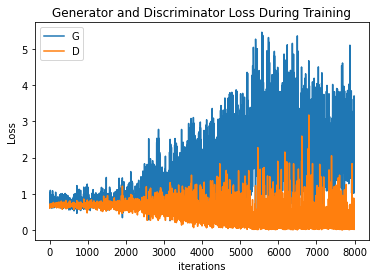

In [23]:
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses,label="G")
plt.plot(D_losses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

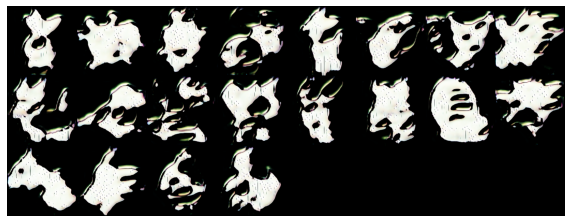

In [24]:
fig = plt.figure(figsize=(10, 10))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i, (1, 2, 0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, blit=True)

HTML(ani.to_jshtml())

За 10 эпох дискриминатор что-то научился отличать, а генератор только понял, что нужно разкрашивать не фон, а то что внутри (тоже успех?) (без  дилатации он и этого понять не мог)

## **Бонус!** (10 баллов)

Давай попробуем добавить ещё один рычаг контроля над GANом - в качестве условия будем передавать не только границы, но и основной цвет, которым мы хотим покемона покрасить. Ведь, как видно в примерах с сумками и туфлями, одни лишь границы не могут влиять на цветовую гамму. 

Над чем тут нужно подумать:
 - как его извлекать из первоначальной картинки? Пиши словами что думаешь (1 балл)
 - как передавать ещё одно условие модели - оно может быть как-то передано в закодированном виде модели на вход отдельно от границ, а может быть закодировано в той же картинке что и границы. Что думаешь? (2 балла)

Модернизируй (если надо) генератор и обучи их с дискриминатором на новых данных, сравни как изменятся предсказания на том же тесте (если на тесте тоже подавать условие цвета) (6 баллов).

Для любой картинки отрисуй несколько вариантов работы генератора на инференсе в зависимости от подаваемого цвета (1 балл).

Попробую использовать [Median Cut algorithm](https://muthu.co/reducing-the-number-of-colors-of-an-image-using-median-cut-algorithm/) который выглядит как: 


1.   Move all pixels into a single large bucket.
2.   Find the color channel (red, green, or blue) in the image with the greatest range.
3. Sort the pixels by that channel values.
4. Find the median and cut the region by that pixel.
5. Repeat the process for both buckets until you have the desired number of colors.
и постепенно выкидывает цвета из картинки. Буду спускаться до 1 цвета и считать его главным.  Реализацию взял [тут](https://github.com/fengsp/color-thief-py)

Если раньше генератору подавалась одноканальная граница, то теперь буду подавать трехканальную, в которой граница покрашена в мой цвет (надеюсь это сработает)

А надо в лоссе учитывать главный цвет картинки, или оно само как-то поймет..


In [25]:
dataset_test = PairedDataset("/content/test_data/data", transform=transform, colored=True)
dataset_train = PairedDataset("/content/train_data/data", transform=transform, colored=True)

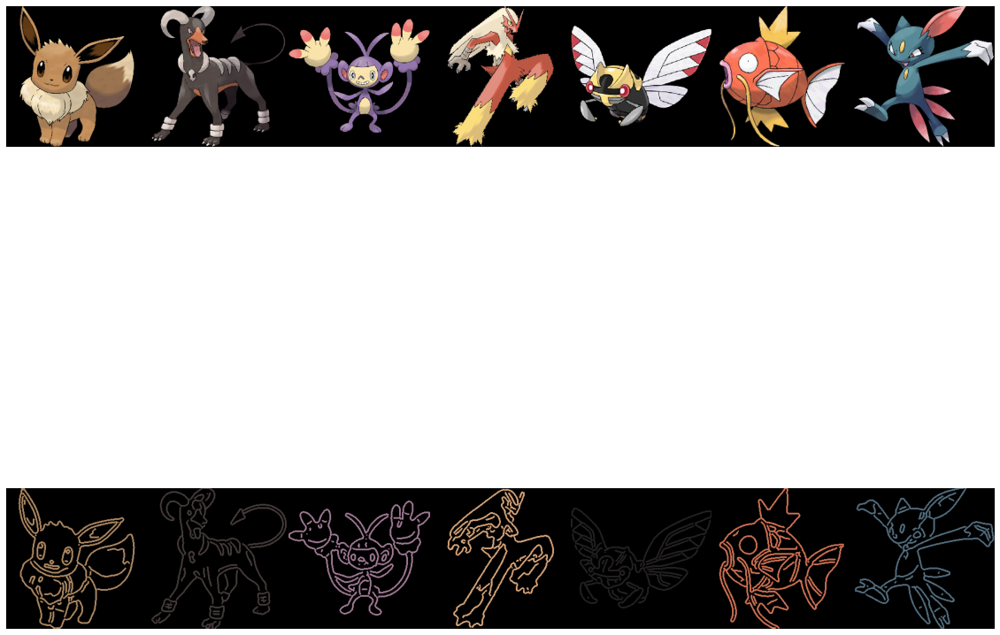

In [26]:
size = 7
fig, ax = plt.subplots(2, size, figsize=(20, 20))
fig.subplots_adjust(hspace = .005, wspace=.001)
for i, img in enumerate(dataset_train):
    img = img[0]
    ax.flatten()[i].imshow(unnormalize_img(img))
    ax.flatten()[i].axis('off')

    if i == size - 1:
        break


for i, img in enumerate(dataset_train):
    img = img[1]
    ax.flatten()[i + size].imshow(img.permute(1, 2, 0))
    ax.flatten()[i + size].axis('off')

    if i == size - 1:
        break


In [27]:
criterion = nn.BCEWithLogitsLoss()
netD = Discriminator(3).to(device)
netG = Generator(3, 3).to(device)
init_weights(netD)
init_weights(netG)

batch_size = 1
num_epochs = 50
lr = 0.0002
beta1 = 0.5 



real_label = 1.
fake_label = 0.

optimizerD = optim.Adam(netD.parameters(), lr=lr, betas=(beta1, 0.999))
optimizerG = optim.Adam(netG.parameters(), lr=lr, betas=(beta1, 0.999))

lambdaD = lambda epoch: 1 - epoch / (num_epochs + 1)
lambdaG = lambda epoch: 1 - epoch / (num_epochs + 1)

schedulerD = LambdaLR(optimizerD, lr_lambda=lambdaD)
schedulerG = LambdaLR(optimizerG, lr_lambda=lambdaG)

dataloader = torch.utils.data.DataLoader(dataset_train, batch_size=batch_size, shuffle=True, num_workers=2)

fixed_imgs = next(iter(torch.utils.data.DataLoader(dataset_test, batch_size=len(dataset_test), shuffle=True, num_workers=2)))[1].to(device)

img_list = []
G_losses = []
D_losses = []
iters = 0



print("Training...")
for epoch in range(num_epochs):
    for i, data in enumerate(dataloader, 0):

        ############################
        # (1) Шаг дискриминатора: maximize log(D(x)) + log(1 - D(G(z)))
        ###########################
        ## Сперва реальный батч
        netD.zero_grad()
        real_batch = data[0].to(device)
        b_size = real_batch.size(0)
        label = torch.full((b_size,), real_label, dtype=torch.float, device=device)

        # Forward и backward по реальному батчу
        output = netD(real_batch).view(b_size, -1).mean(1)
        errD_real = criterion(output, label)
        errD_real.backward()
        D_x = output.mean().item() #средним ответ дискриминатора на реальных данных

        ## Теперь фейковый батч
        # генерим батч шума и получаем выход генератора на нём
        fake_batch = netG(data[1].to(device))
        label.fill_(fake_label)

        # Forward и backward по фейковому батчу
        output = netD(fake_batch.detach()).view(b_size, -1).mean(1)
        errD_fake = criterion(output, label)
        errD_fake.backward()
        D_G_z1 = output.mean().item()
        
        #собираем все градиенты и делаем шаг
        errD = (errD_real + errD_fake) * 0.5
        optimizerD.step()

        ############################
        # (2) Шаг генератора: maximize log(D(G(z)))
        ###########################
        netG.zero_grad()
        label.fill_(real_label)  # тонкий момент: фейковые лейблы в терминах генератора - реальные
        
        # мы обновили D, прогоним через одновленную сеть фейки ещё раз
        output = netD(fake_batch).view(b_size, -1).mean(1)
        errG = criterion(output, label)
        errG.backward()
        D_G_z2 = output.mean().item() #смотрим как изменилось на том же фейке поведение дискриминатора
        optimizerG.step()

        # просто логи
        if i % 500 == 0:
            print('[%d/%d][%d/%d] Loss_D: %.4f Loss_G: %.4f  D(x): %.4f D(G(z)): %.4f -> %.4f'
                  % (epoch+1, num_epochs, i, len(dataloader), errD.item(), errG.item(), D_x, D_G_z1, D_G_z2))

        # сохраняем лоссы для будущего графика
        G_losses.append(errG.item())
        D_losses.append(errD.item())

        # сохраняем результаты на фиксированном входе генератора
        if (iters % 500 == 0) or ((epoch == num_epochs-1) and (i == len(dataloader)-1)):
            with torch.no_grad():
                fake = netG(fixed_imgs).detach().cpu()
            img_list.append(vutils.make_grid(fake, padding=2, normalize=True))

        iters += 1
    schedulerG.step()
    schedulerD.step()

Training...
[1/50][0/799] Loss_D: 0.6893 Loss_G: 0.6284  D(x): -0.1510 D(G(z)): -0.1800 -> 0.1339
[1/50][500/799] Loss_D: 0.5614 Loss_G: 0.8848  D(x): 0.1195 D(G(z)): -0.4646 -> -0.3524
[2/50][0/799] Loss_D: 0.7402 Loss_G: 0.9263  D(x): 1.2199 D(G(z)): 0.8726 -> -0.4222
[2/50][500/799] Loss_D: 0.5069 Loss_G: 1.1440  D(x): 0.9657 D(G(z)): -0.0040 -> -0.7605
[3/50][0/799] Loss_D: 0.7738 Loss_G: 0.9711  D(x): -0.6306 D(G(z)): -0.4577 -> -0.4953
[3/50][500/799] Loss_D: 0.4649 Loss_G: 1.1971  D(x): 0.0419 D(G(z)): -1.2257 -> -0.8374
[4/50][0/799] Loss_D: 0.6696 Loss_G: 1.1001  D(x): 0.3682 D(G(z)): 0.2276 -> -0.6954
[4/50][500/799] Loss_D: 0.5813 Loss_G: 1.1529  D(x): -0.0100 D(G(z)): -0.5256 -> -0.7735
[5/50][0/799] Loss_D: 0.5177 Loss_G: 1.7601  D(x): 1.0927 D(G(z)): 0.1033 -> -1.5714
[5/50][500/799] Loss_D: 0.9054 Loss_G: 0.5701  D(x): -0.0538 D(G(z)): 0.6809 -> 0.2633
[6/50][0/799] Loss_D: 0.2940 Loss_G: 1.3338  D(x): 1.7418 D(G(z)): -0.6310 -> -1.0280
[6/50][500/799] Loss_D: 0.6124 Los

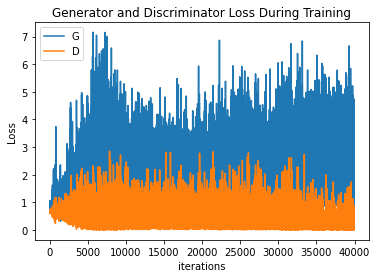

In [28]:
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses,label="G")
plt.plot(D_losses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

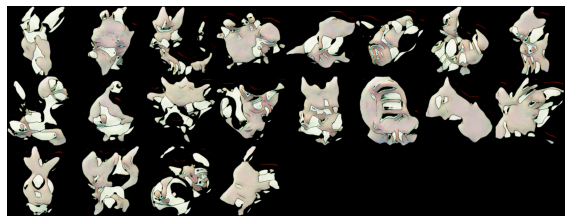

In [29]:
fig = plt.figure(figsize=(10, 10))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i, (1, 2, 0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, blit=True)

HTML(ani.to_jshtml())

In [30]:
def image2borders(img, color):
    gray = rgb2gray(img.permute(1, 2, 0))
    can = canny(gray, 2.5)
    can = binary_dilation(can)
    result = torch.from_numpy(can).float()
    result.unsqueeze_(0)
    result = result.repeat(3, 1, 1)
    for i in range(3):
        result[i, :, :] *= color[i]
    result /= 255.0
    return result

AttributeError: ignored

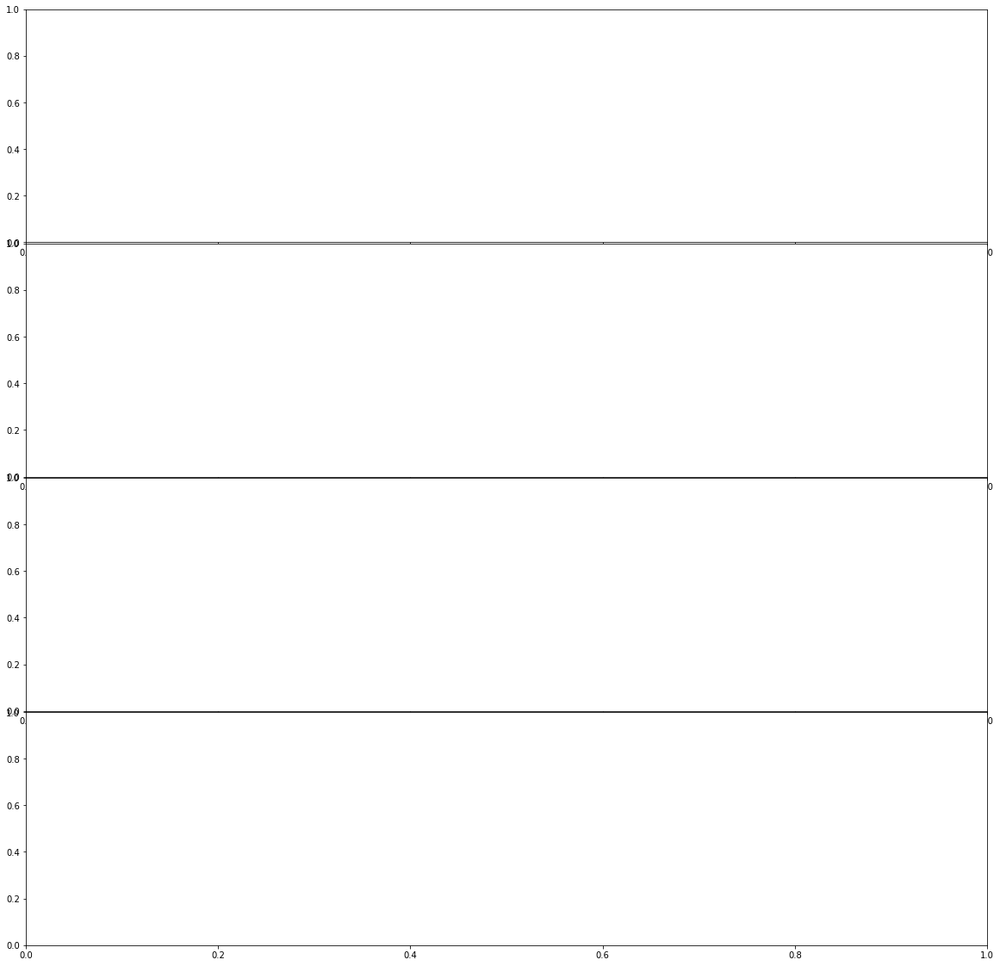

In [31]:
img = dataset_train[0]
fig, ax = plt.subplots(4,  figsize=(20, 20))
fig.subplots_adjust(hspace = .005, wspace=.001)

ax[0].imshow(img.permute(1, 2, 0))
ax[0].axis('off')

for ind, color in enumerate([(255, 1, 1), (56, 31, 108), (255, 241, 31)]):
    borders = image2borders(img, color)
    colored = netG(borders.squeeze_(0).to(device)).detach().cpu()
    ax[ind].imshow(img.permute(1, 2, 0)) 
    ax[ind].axis('off')

AttributeError: ignored

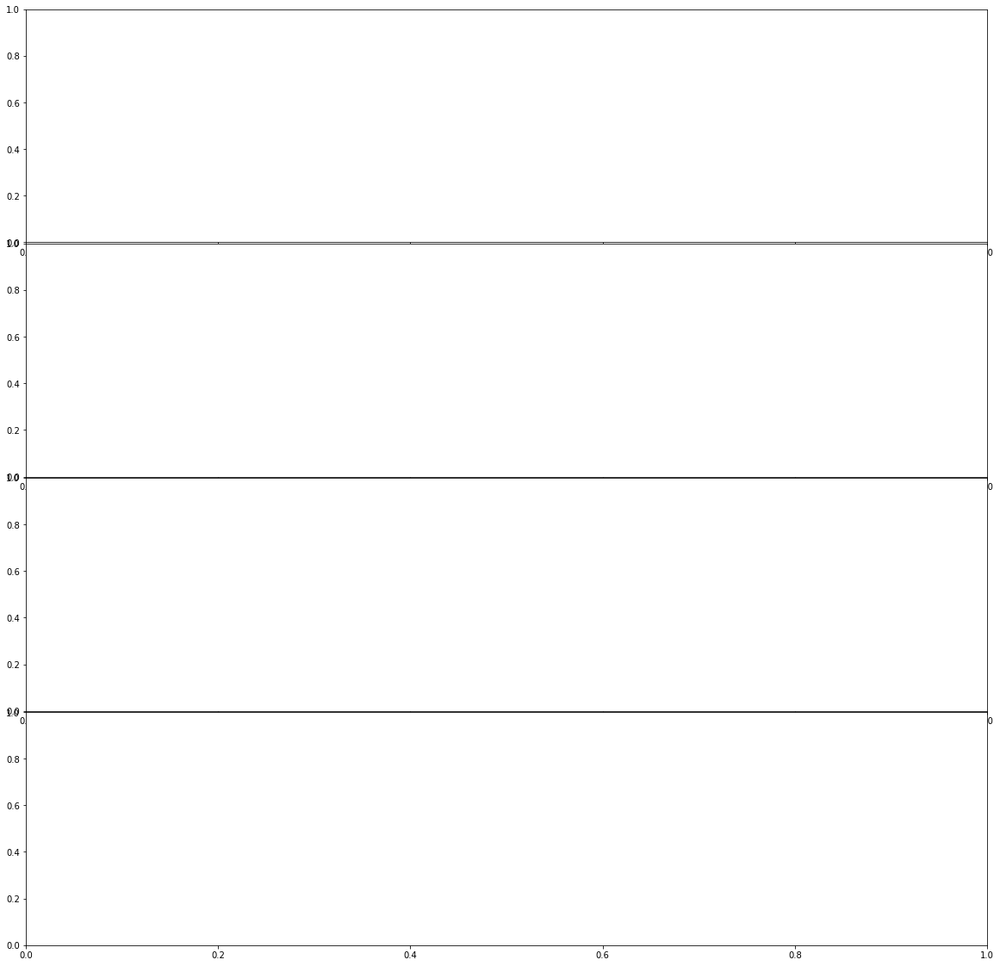

In [32]:
img = dataset_train[0]
fig, ax = plt.subplots(4,  figsize=(20, 20))
fig.subplots_adjust(hspace = .005, wspace=.001)

ax[0].imshow(img.permute(1, 2, 0))
ax[0].axis('off')

for ind, color in enumerate([(255, 1, 1), (56, 31, 108), (255, 241, 31)]):
    borders = image2borders(img, color)
    colored = netG(borders.squeeze_(0).to(device)).detach().cpu()
    ax[ind].imshow(img.permute(1, 2, 0)) 
    ax[ind].axis('off')

**Вот и всё. Какие же мы молодцы ^^**